# Pairwise pearsonr analysys

In [1]:
%reload_ext autoreload
%autoreload 2

In [2]:
SOCKSHOP_DATASET_ID = "9n6mf"

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy

plt.rcParams["font.family"] = "DejaVu Sans"
plt.rcParams["font.size"] = 7
plt.rcParams['xtick.labelsize'] = 8
plt.rcParams['ytick.labelsize'] = 8
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['axes.linewidth'] = 1.0
plt.rcParams['axes.grid'] = True

In [4]:
import sys
sys.path.append('../')

In [5]:
from eval.tsdr import load_tsdr_by_chaos

dataset_by_chaos = load_tsdr_by_chaos(
    SOCKSHOP_DATASET_ID, 
    metric_types={
        "services": True,
        "containers": True,
        "middlewares": True,
        "nodes": False,
    },
    revert_normalized_time_series=True,
    tsdr_options={
        "enable_unireducer": False,
        "enable_multireducer": False,
    },
    use_manually_selected_metrics=False,
    validation_filtering=(True, 4*5)
)

In [6]:
import pandas as pd

record, data_df_by_metric_type = dataset_by_chaos[("pod-memory-hog", "user-db")][0]
dataset = pd.concat([
    data_df_by_metric_type["containers"][0],
    data_df_by_metric_type["services"][0],
    data_df_by_metric_type["middlewares"][0],
], axis=1)
dataset.shape

(180, 1423)

In [7]:
def max_xcorr_pair(a: np.ndarray, b: np.ndarray) -> np.ndarray:
    a_dev = a - a.mean()
    b_dev = b - b.mean()
    xc_ab = np.correlate(a_dev, b_dev, mode="full")
    xc_ab /= np.linalg.norm(a_dev, ord=2) * np.linalg.norm(b_dev, ord=2)  # normalize
    return np.max(np.abs(xc_ab))

In [8]:
# for metric in dataset.columns:
#     print(metric)
#     if record.pk.get_container_by_metric(metric) == record.chaos_comp():
#         print(metric, record.pk.get_container_by_metric(metric))
cols = [record.pk.get_container_by_metric(metric) == record.chaos_comp() for metric in dataset.columns]
cause_data = dataset.loc[:, cols]
corr = cause_data.corr().abs()

In [9]:
corr.shape

(261, 261)

In [10]:
import seaborn as sns

In [11]:
w = corr.shape[0] * 0.5
sns.clustermap(corr, method="complete", cmap='RdBu', annot=True, 
               annot_kws={"size": 7}, vmin=0, vmax=1, figsize=(w,w))

/home/ubuntu/src/github.com/ai4sre/meltria-analyzer/.venv/lib/python3.10/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


In [12]:
from collections import defaultdict
import hdbscan

In [13]:
mapping = {i: metric for i, metric in enumerate(corr.columns)}
dist_mat = (1-corr).to_numpy()
clusterer = hdbscan.HDBSCAN(
    min_cluster_size=2,
    metric="precomputed",
    allow_single_cluster=False,
    cluster_selection_method="leaf",
).fit(dist_mat)
cluster_to_metric_names = defaultdict(list)
for i, label in enumerate(clusterer.labels_):
    cluster_to_metric_names[label].append(mapping[i])
for cluster, vals in sorted(cluster_to_metric_names.items()):
    print(cluster, [clusterer.cluster_persistence_[cluster]] if cluster != -1 else [], vals)

-1 [] ['c-user-db_fs_writes_total', 'c-user-db_threads', 'c-user-db_cpu_cfs_periods_total', 'c-user-db_fs_writes_bytes_total', 'm-user-db_mongodb_ss_uptimeMillis', 'm-user-db_mongodb_ss_uptime', 'm-user-db_mongodb_ss_wt_lock_dhandle_read_lock_acquisitions', 'm-user-db_mongodb_sys_netstat_IpExt_InOctets', 'm-user-db_mongodb_ss_wt_data_handle_connection_sweep_time_of_death_sets', 'm-user-db_mongodb_sys_cpu_procs_running', 'm-user-db_mongodb_sys_cpu_ctxt', 'm-user-db_mongodb_ss_wt_block_manager_bytes_written', 'm-user-db_mongodb_ss_wt_cursor_cursor_reset_calls', 'm-user-db_mongodb_ss_wt_cursor_cursor_create_calls', 'm-user-db_mongodb_sys_netstat_TcpExt_TCPOrigDataSent', 'm-user-db_mongodb_ss_wt_connection_memory_allocations', 'm-user-db_mongodb_ss_tcmalloc_tcmalloc_pageheap_committed_bytes', 'm-user-db_mongodb_ss_wt_data_handle_connection_data_handles_currently_active', 'm-user-db_mongodb_ss_wt_cursor_cursor_sweep_buckets', 'm-user-db_mongodb_ss_wt_txn_transactions_rolled_back', 'm-user-d

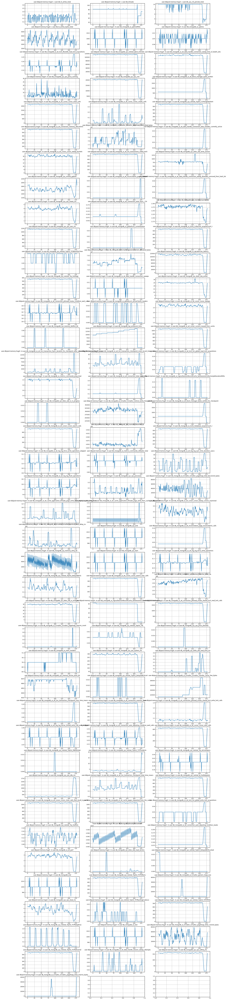

In [14]:
# visualize noise clusters
from notebooklib.plot import plot_dataset_dataframe

plot_dataset_dataframe(record.data_df[cluster_to_metric_names[-1]], record=record)

In [15]:
def cluster_medoid(clusterer, dist_mat):
    mask = np.array(clusterer.labels_ == cluster_id)
    cluster_membership_strengths = clusterer.probabilities_[mask]
    dm = dist_mat[:, mask] * cluster_membership_strengths
    medoid_index = np.argmin(dm.sum(axis=1))
    return medoid_index

cluster_to_medoid = {}
for cluster_id in cluster_to_metric_names.keys():
    if cluster_id == -1:
        continue
    medoid = cluster_medoid(clusterer, dist_mat)
    cluster_to_medoid[cluster_id] = mapping[medoid]

In [16]:
cluster_to_medoid

{19: 'c-user-db_cpu_usage_seconds_total',
 24: 'c-user-db_network_receive_bytes_total',
 9: 'c-user-db_memory_rss',
 11: 'c-user-db_fs_reads_bytes_total',
 14: 'm-user-db_mongodb_sys_memory_Active_file_kb',
 26: 'm-user-db_mongodb_ss_locks_oplog_acquireCount_r',
 18: 'm-user-db_mongodb_sys_netstat_Tcp_PassiveOpens',
 31: 'm-user-db_mongodb_ss_tcmalloc_tcmalloc_thread_cache_free_bytes',
 38: 'm-user-db_mongodb_ss_network_bytesIn',
 15: 'm-user-db_mongodb_top_total_time',
 5: 'm-user-db_mongodb_ss_tcmalloc_tcmalloc_pageheap_scavenge_count',
 32: 'm-user-db_mongodb_ss_wt_cache_pages_written_from_cache',
 12: 'm-user-db_mongodb_ss_metrics_commands_replSetGetConfig_failed',
 29: 'm-user-db_mongodb_top_readLock_count',
 0: 'm-user-db_mongodb_sys_netstat_TcpExt_TCPDSACKIgnoredNoUndo',
 8: 'm-user-db_mongodb_ss_tcmalloc_tcmalloc_pageheap_unmapped_bytes',
 16: 'm-user-db_mongodb_sys_disks_sda_write_time_ms',
 39: 'm-user-db_mongodb_ss_metrics_document',
 20: 'm-user-db_mongodb_ss_wt_log_total_s

In [17]:
import math
import ruptures as rpt

/home/ubuntu/src/github.com/ai4sre/meltria-analyzer/.venv/lib/python3.10/site-packages/ruptures/costs/costnormal.py:28: UserWarning: New behaviour in v1.1.5: a small bias is added to the covariance matrix to cope with truly constant segments (see PR#198).
  warnings.warn(


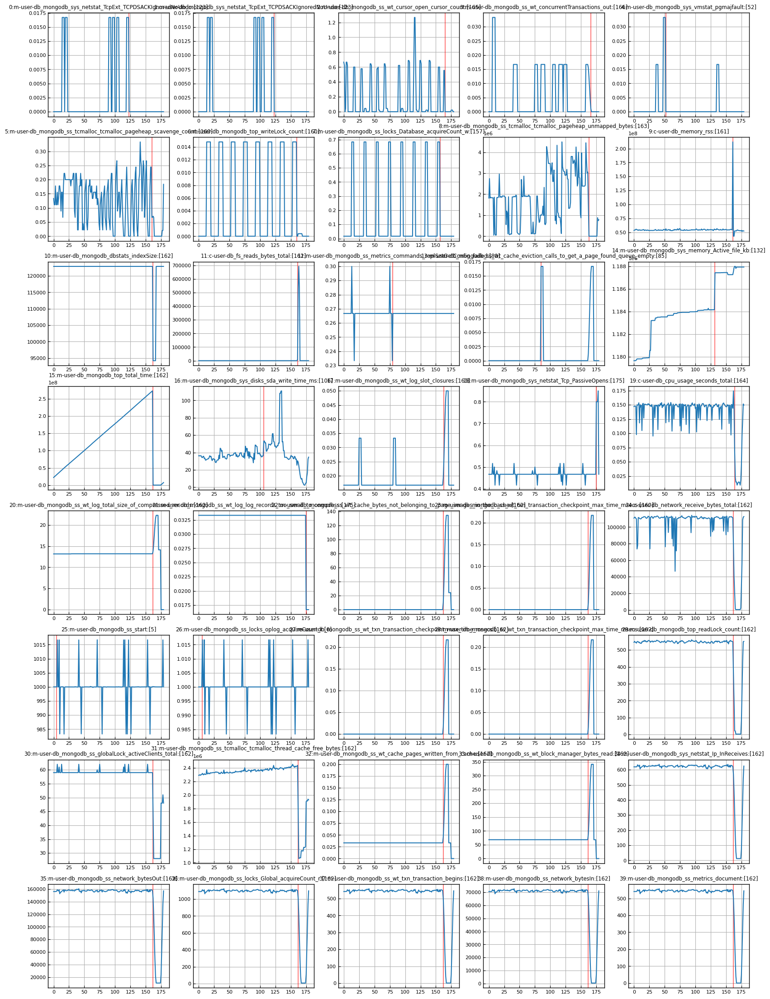

In [18]:
cluster_id_to_bkp = {}
fig, axs = plt.subplots(math.ceil(len(cluster_to_medoid)/5), ncols=5)
fig.set_size_inches(20, 0.7*len(cluster_to_medoid))
for ax, (cluster_id, medoid) in zip(axs.flatten(), sorted(cluster_to_medoid.items())):
    x = cause_data[medoid].to_numpy()
    algo = rpt.Binseg(model='normal', jump=1).fit(x)
    bkps = algo.predict(n_bkps=1)[:-1]
    for bkp in bkps:
        ax.axvline(bkp, color='red', alpha=0.5)
    cluster_id_to_bkp[cluster_id] = bkps[0]
    ax.set_title(f"{cluster_id}:{medoid}:{bkps}")
    ax.plot(x)

In [19]:
bkps = list(cluster_id_to_bkp.values())
bkp_clusterer = hdbscan.HDBSCAN(
    min_cluster_size=2,
    metric="euclidean",
    allow_single_cluster=True,
    # cluster_selection_method="leaf",
).fit(np.array([bkps]).T)

In [20]:
bkp_cluster_id_to_cluster_ids = defaultdict(list)
bkp_cluster_id_to_bkps = defaultdict(list)
for i, bkp_cluster_id in enumerate(bkp_clusterer.labels_):
    bkp_cluster_id_to_cluster_ids[bkp_cluster_id].append(i)
    bkp_cluster_id_to_bkps[bkp_cluster_id].append(bkps[i])
bkp_cluster_id_to_cluster_ids, bkp_cluster_id_to_bkps

(defaultdict(list,
             {0: [0, 1, 13, 14, 16],
              -1: [2, 3, 4, 6, 7, 11, 12, 18, 21, 25, 26],
              2: [5, 9],
              1: [8, 17, 19],
              3: [10,
               15,
               20,
               22,
               23,
               24,
               27,
               28,
               29,
               30,
               31,
               32,
               33,
               34,
               35,
               36,
               37,
               38,
               39]}),
 defaultdict(list,
             {0: [123, 123, 85, 132, 106],
              -1: [165, 166, 52, 160, 157, 161, 80, 175, 175, 5, 6],
              2: [160, 161],
              1: [163, 163, 164],
              3: [162,
               162,
               162,
               162,
               162,
               162,
               162,
               162,
               162,
               162,
               162,
               162,
               162,
      

In [21]:
most_previous_bkp_cluster_id = -1
most_previous_bkp = -1
for cid, bkps in bkp_cluster_id_to_bkps.items():
    min_bkp = min(bkps)
    if most_previous_bkp == -1:
        most_previous_bkp = min_bkp
        most_previous_bkp_cluster_id = cid
        continue
    if min_bkp < most_previous_bkp:
        most_previous_bkp = min_bkp
        most_previous_bkp_cluster_id = cid
most_previous_cluster_ids = bkp_cluster_id_to_cluster_ids[most_previous_bkp_cluster_id]
most_previous_cluster_ids

[2, 3, 4, 6, 7, 11, 12, 18, 21, 25, 26]

In [22]:
keep_metric_names = []
for cid, metric_names in cluster_to_metric_names.items():
    if cid in most_previous_cluster_ids:
        keep_metric_names.extend(metric_names)
len(keep_metric_names), keep_metric_names

(42,
 ['c-user-db_fs_reads_total',
  'c-user-db_fs_reads_bytes_total',
  'c-user-db_cpu_cfs_throttled_seconds_total',
  'c-user-db_cpu_cfs_throttled_periods_total',
  'c-user-db_blkio_device_usage_total',
  'm-user-db_mongodb_ss_locks_oplog_acquireCount_r',
  'm-user-db_mongodb_ss_uptimeEstimate',
  'm-user-db_mongodb_ss_metrics_commands_getnonce_total',
  'm-user-db_mongodb_sys_netstat_Tcp_PassiveOpens',
  'm-user-db_mongodb_sys_netstat_TcpExt_TCPRcvCoalesce',
  'm-user-db_mongodb_ss_connections',
  'm-user-db_mongodb_ss_mem_virtual',
  'm-user-db_mongodb_ss_metrics_commands_getCmdLineOpts_total',
  'm-user-db_mongodb_ss_metrics_commands_replSetGetConfig_failed',
  'm-user-db_mongodb_ss_metrics_commands_getDiagnosticData_total',
  'm-user-db_mongodb_ss_metrics_commands_replSetGetConfig_total',
  'm-user-db_mongodb_ss_wt_cursor_cached_cursor_count',
  'm-user-db_mongodb_ss_wt_session_open_session_count',
  'm-user-db_mongodb_ss_wt_cursor_open_cursor_count',
  'm-user-db_mongodb_ss_logi

## Change point based clustering

In [23]:
import numpy as np
from scipy import stats

from tsdr.outlierdetection.spot import spot
from tsdr.outlierdetection.n_sigma_rule import zscore_nsigma

def cusum(X):
    X_mean = np.mean(X)
    S = np.cumsum(X - X_mean)
    Sb = max(S) - min(S)
    return S, Sb

def bootstrap(X, n=1000):
    Sb_samples = np.zeros(n)
    for i in range(n):
        X_bootstrap = np.random.choice(X, size=len(X), replace=True)
        _, Sb_bootstrap = cusum(X_bootstrap)
        Sb_samples[i] = Sb_bootstrap
    return Sb_samples

def change_point_detection(X, alpha=0.05):
    _, Sb = cusum(X)
    Sb_samples = bootstrap(X)
    p_value = np.mean(Sb < Sb_samples)
    if p_value < alpha:
        Sc = np.argmax(np.abs(cusum(X)[0]))
        return Sc
    else:
        return None

def omega(X, c):
    X_before = X[:c]
    X_after = X[c:]
    mean_before = np.mean(X_before)
    mean_after = np.mean(X_after)
    return np.abs(mean_before - mean_after) / max(mean_before, mean_after)

# def calculate_tangent(x1, x2):
#     return (x2 - x1) / 1  # assuming time difference is 1

# def rollback(X, cp, threshold=0.3):
#     index = cp
#     while index > 0:
#         tangent1 = calculate_tangent(X[index-1], X.data[index])
#         tangent2 = calculate_tangent(X[index-2], X.data[index-1])
#         print(tangent1, tangent2)

#         if abs(tangent1 - tangent2) < threshold:
#             index -= 1
#         else:
#             break
#     return index

def critical_change_point(X, change_points, rollback_threshold=0.3):
    # pvals = [scipy.stats.ks_2samp(X[:c-1], X[c-1:]).pvalue for c in change_points]
    # change_points = [rollback(X, _, rollback_threshold) for _ in change_points] 
    first_change_point = change_points[0]
    train, test = X[:first_change_point], X[first_change_point:]
    scores = spot(train, test)[0]
    most_anomalous_point = first_change_point + (np.argmax(scores) + 1)
    cp_offsets = []
    for cp in change_points:
        offset = most_anomalous_point - cp
        if offset < 0:
            continue
        cp_offsets.append((cp, offset))
    # omegas = [omega(X, c) for c in change_points]
    # critical_change_point = min(zip(change_points, pvals), key=lambda x: x[1])
    critical_change_point = min(cp_offsets, key=lambda x: x[1])
    return critical_change_point[0]

In [24]:
binseg = rpt.Binseg(model='normal', jump=1)
metric_to_bkp = {}
for col in cause_data.columns.tolist():
    x = cause_data[col].to_numpy()
    algo = binseg.fit(scipy.stats.zscore(x))
    bkps = algo.predict(n_bkps=3)[:-1]
    cp = critical_change_point(x, bkps)
    # print(col, bkps, cp)
    # if cp is None:
    #     cp = algo.predict(n_bkps=1)[:-1]
    metric_to_bkp[col] = cp

/home/ubuntu/src/github.com/ai4sre/meltria-analyzer/.venv/lib/python3.10/site-packages/ruptures/costs/costnormal.py:28: UserWarning: New behaviour in v1.1.5: a small bias is added to the covariance matrix to cope with truly constant segments (see PR#198).
  warnings.warn(


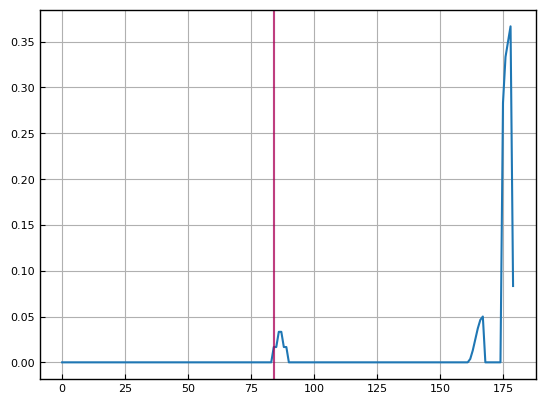

In [25]:
baseline = "m-user-db_mongodb_ss_mem_virtual"
_x = cause_data[baseline].to_numpy()
algo = binseg.fit(scipy.stats.zscore(_x))
_bkps = algo.predict(n_bkps=1)[:-1]
cp = critical_change_point(_x, _bkps)
plt.plot(_x)
for _bkp in _bkps:
    plt.axvline(_bkp, color='blue', alpha=0.5)
plt.axvline(cp, color='red', alpha=0.5)

In [26]:
# Multivariate breakpoints
# _binseg = rpt.Binseg(model='normal', jump=1)
# _X = cause_data.to_numpy()
# print(_X.shape)
# pen = np.log(_X.shape[0]) * _X.shape[1] * _X.std()**2
# print(pen)
# print(_binseg.fit(_X).predict(pen=pen)[:-1])

In [27]:
bkps = list(metric_to_bkp.values())
bkp_clusterer = hdbscan.HDBSCAN(
    min_cluster_size=2,
    metric="euclidean",
    allow_single_cluster=True,
    # cluster_selection_method="leaf",
).fit(np.array([bkps]).T)

In [28]:
cluster_id_to_metric_names = defaultdict(list)
for metric, cluster_id, in zip(cause_data.columns.tolist(), bkp_clusterer.labels_):
    cluster_id_to_metric_names[cluster_id].append((metric, metric_to_bkp[metric]))

/tmp/ipykernel_5467/735620459.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(math.ceil(len(metrics)/4), ncols=4)


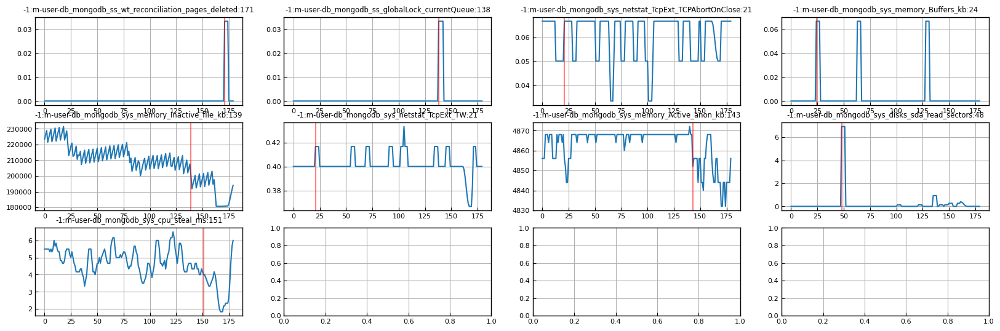

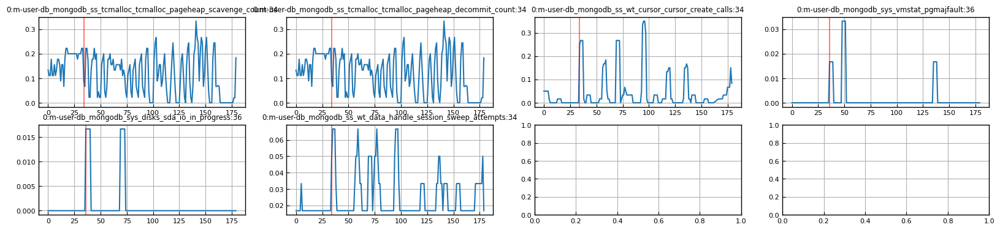

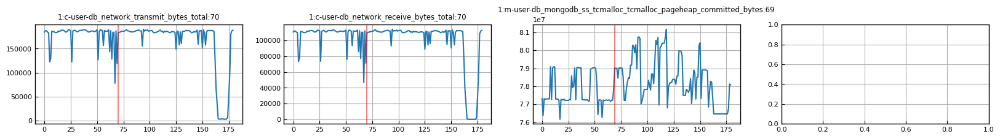

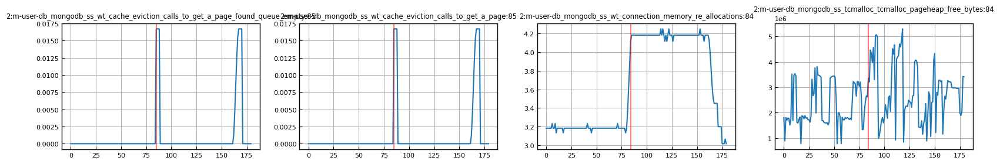

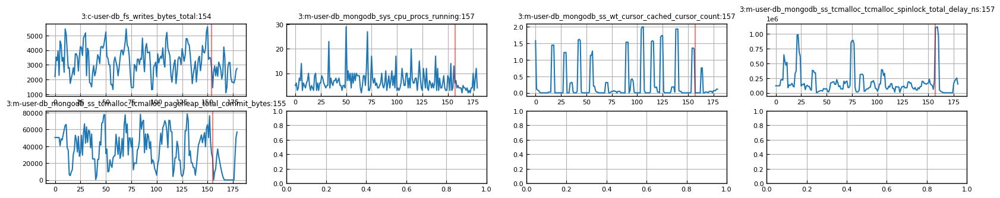

...

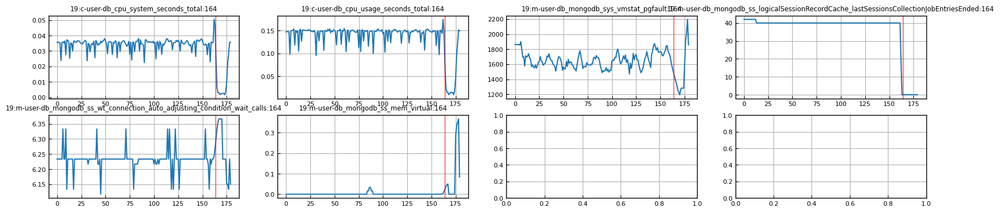

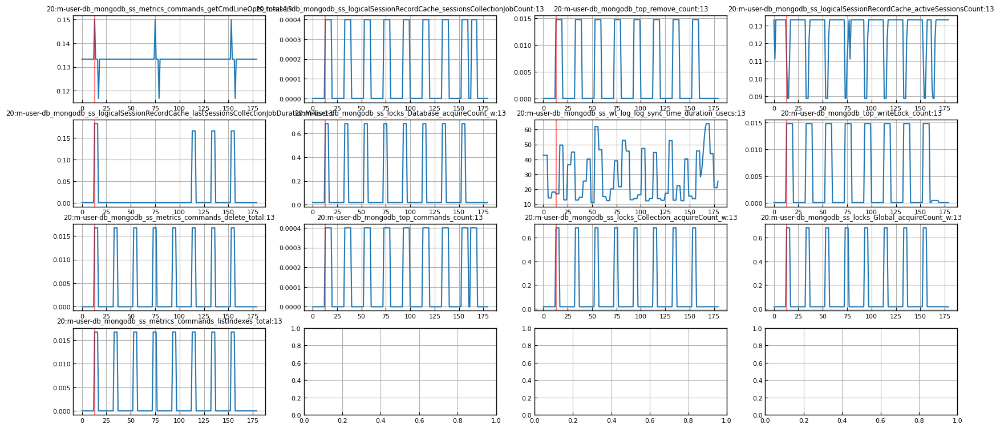

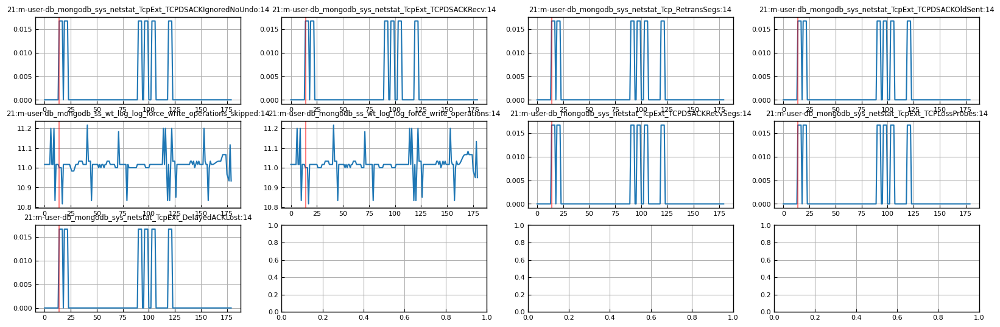

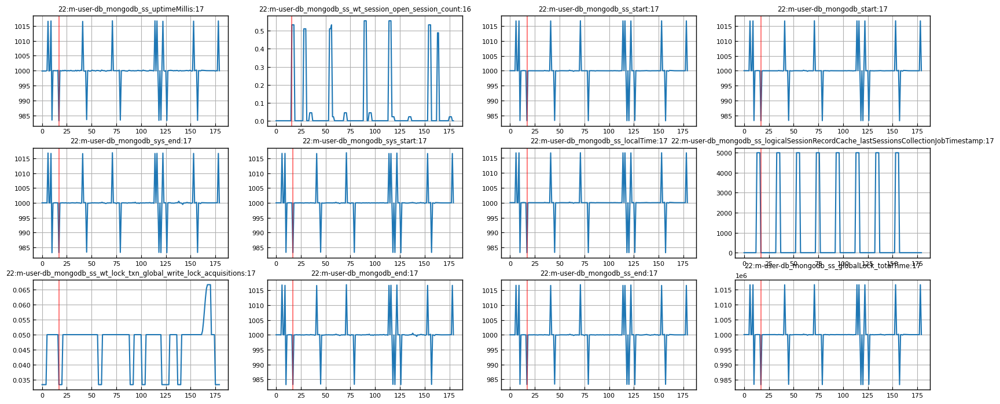

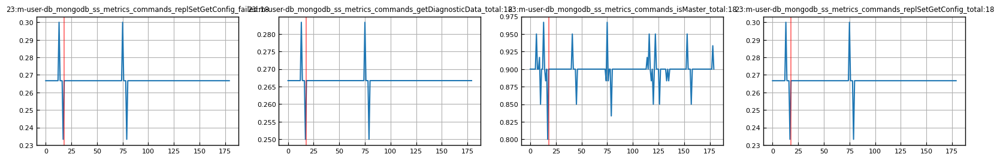

In [29]:
plt.close()
for cluster_id, metrics in sorted(cluster_id_to_metric_names.items(), key=lambda k: k[0]):
    fig, axs = plt.subplots(math.ceil(len(metrics)/4), ncols=4)
    fig.set_size_inches(20, 0.7*len(metrics))
    for ax, (metric, bkp) in zip(axs.flatten(), metrics):
        x = cause_data[metric].to_numpy()
        ax.plot(x)
        ax.axvline(bkp, color='red', alpha=0.5)
        ax.set_title(f"{cluster_id}:{metric}:{bkp}")